In [1]:
from skimage.io import imread
import os 
import numpy as np 
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy.ndimage import gaussian_filter

In [2]:
def compute_grads(h): 
    # Get gradients
    hy, hx = np.gradient(h)
    # Get second derivatives
    hyy, hyx = np.gradient(hy)
    hxy, hxx = np.gradient(hx)
    return hx, hy, hxx, (hxy+hyx)/2, hyy 


def compute_principle_curvatures(h, h_cutoff = 10, cur_cutoff = -1):
    hx, hy, hxx, hxy, hyy = compute_grads(h)
    
    # Mean curvature formula for a surface z = h(x,y)
    numerator = (1 + hx**2)*hyy - 2*hx*hy*hxy + (1 + hy**2)*hxx
    denominator = 2*(1 + hx**2 + hy**2)**(3/2)
    H = numerator/denominator

    numerator = hxx*hyy - hxy**2
    denominator = (1 + hx**2 + hy**2)**2
    K = numerator/denominator

    mask = (K > cur_cutoff) & (h > h_cutoff)

    k1 = H + np.sqrt(H**2 - K)
    k2 = H - np.sqrt(H**2 - K)

    k1_masked = np.where(mask, k1, np.nan)
    k2_masked = np.where(mask, k2, np.nan)

    return k1_masked, k2_masked

/var/folders/5n/0rvnm9350db7gk5vdnj3tn6h0000gn/T/ipykernel_73780/242869046.py:5: RuntimeWarning: invalid value encountered in sqrt
  Z = np.sqrt(100**2 - X**2 - Y**2)


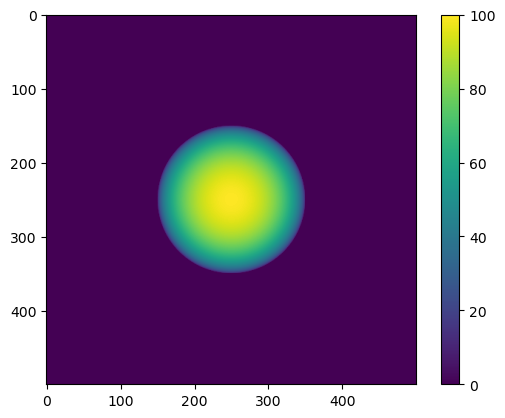

0.1218708000628045
-0.013013494363717473


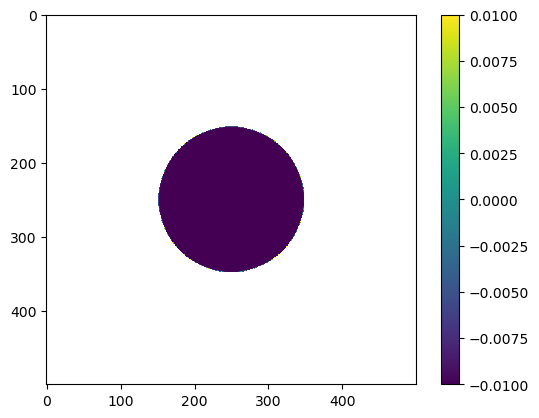

In [24]:
x = np.linspace(0, 499, 500) - 250
y = np.linspace(0, 499, 500) - 250

X, Y = np.meshgrid(x, y)
Z = np.sqrt(100**2 - X**2 - Y**2) 
Z[np.isnan(Z)] = 0

plt.imshow(Z)
plt.colorbar() 
plt.show() 

k1, k2 = compute_principle_curvatures(Z, h_cutoff = 10, cur_cutoff = -1)

print(np.max(k1[np.isfinite(k1)]))
print(np.min(k1[np.isfinite(k1)]))

plt.imshow(k1, vmin=-0.01, vmax=0.01)
plt.colorbar() 
plt.show() 

In [24]:
dir = '../data/height_map/' 
listdir = os.listdir(dir)
tif_files = [f for f in listdir if f.endswith('tif')]

embryos = [] 
for f in tif_files: 
    heights = imread(dir + f)
    print(heights.shape) 
    embryos.append(heights)

(52, 555, 576)
(62, 546, 625)
(50, 541, 571)
(60, 560, 621)


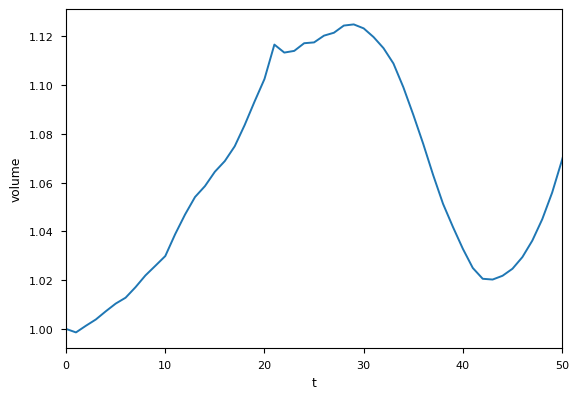

In [25]:
heights = embryos[0] 

volumes = np.sum(heights, axis=(1, 2))
plt.plot(volumes/volumes[0])
plt.xlim([0, 50])
plt.ylabel('volume')
plt.xlabel('t')
plt.show() 

In [26]:
t  = -1

h = heights[t] 
sigma = 10
h_smooth = gaussian_filter(h, sigma=sigma)

Ly = heights.shape[1] 
Lx = heights.shape[2]
print(Lx, Ly)
x = np.arange(Lx)
y = np.arange(Ly)
x, y = np.meshgrid(x, y)

fig = go.Figure(data=[go.Surface(x=x, y=y, z=h_smooth)])

fig.update_layout(
    title='Surface',
    scene = dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z', 
        aspectratio=dict(x=1, y=1, z=0.25)
    ),
    width=600,
    height=400
)

fig.show()

576 555


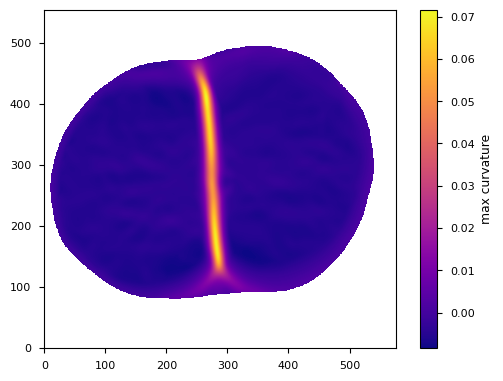

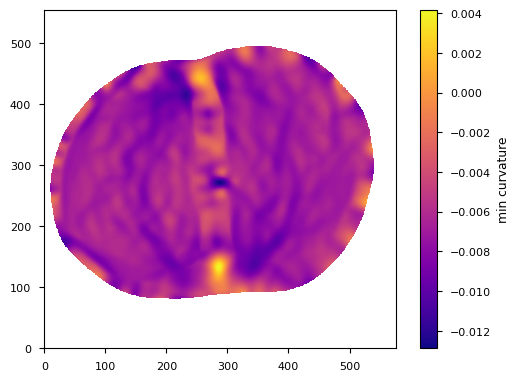

In [27]:
k1, k2 = compute_principle_curvatures(h_smooth, h_cutoff=60, cur_cutoff=-1)

plt.imshow(k1, cmap='plasma', origin='lower')
plt.colorbar(label='max curvature')
plt.show() 

plt.imshow(k2, cmap='plasma', origin='lower')
plt.colorbar(label='min curvature')
plt.show() 

In [28]:
fig = go.Figure(data=[go.Surface(x=x, y=y, z=k1)])

fig.update_layout(
    title='curvature',
    scene = dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='max curvature', 
    ),
    width=600,
    height=600
)

fig.show()

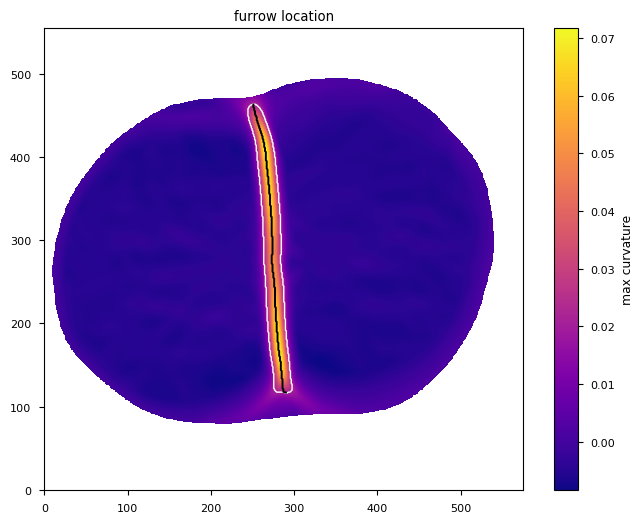

In [29]:
# Find ridge by thresholding k1 (maximum curvature)
ridge_mask = k1 > np.nanpercentile(k1, 96)  # Top 5% of curvature values
y_coords = np.where(ridge_mask)[0]
x_coords = np.where(ridge_mask)[1]
y_f= np.unique(y_coords)
x_f = np.array([np.mean(x_coords[y_coords == y]).astype(int) for y in y_f])

# Overlay ridge on original curvature map
plt.figure(figsize=(8, 6))
plt.imshow(k1, cmap='plasma', origin='lower')
plt.colorbar(label='max curvature')
plt.contour(ridge_mask, colors='white', linewidths=1)
plt.plot(x_f, y_f, 'k-')
plt.title('furrow location')
plt.show()

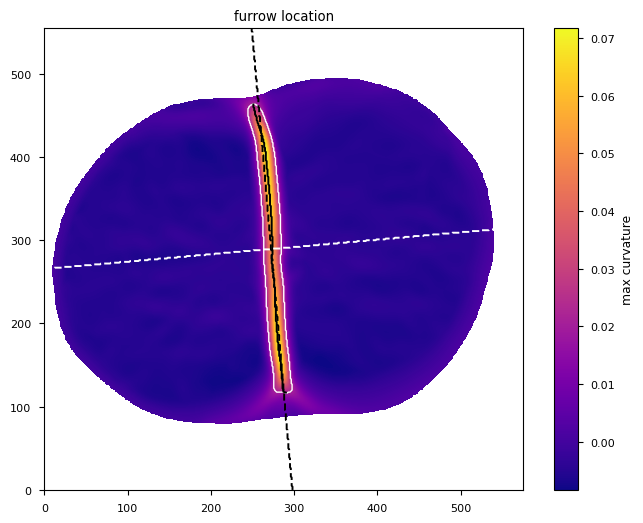

In [30]:
# compute the line orthogonal to the furrow 
slope = np.polyfit(x_f, y_f, 1)[0]
midpoint = [np.mean(x_f), np.mean(y_f)] 
slope_perp = -1/slope
x_perp = np.arange(0, Lx).astype(int)
y_perp = (slope_perp*(x_perp - midpoint[0]) + midpoint[1]).astype(int)
y_para = np.arange(0, Ly).astype(int)
x_para = (1/slope*(y_para - midpoint[1]) + midpoint[0]).astype(int)


plt.figure(figsize=(8, 6))
plt.imshow(k1, cmap='plasma', origin='lower')
plt.colorbar(label='max curvature')
plt.contour(ridge_mask, colors='white', linewidths=1)
plt.plot(x_f, y_f, 'k-')
plt.plot(x_perp, y_perp, 'w--')
plt.plot(x_para, y_para, 'k--')
plt.title('furrow location')
plt.show()

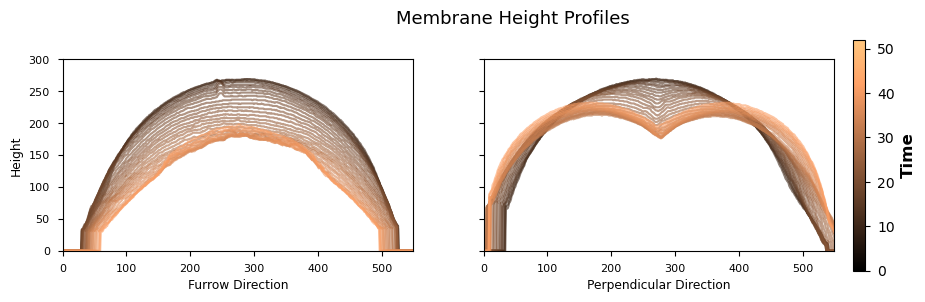

In [31]:
plt.style.use('seaborn-v0_8-paper')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 3), sharey=True)

# Create custom copper colormap with better contrast
arg = np.argmax(heights)
t0, _, _ = np.unravel_index(arg, heights.shape)
copper = plt.cm.copper(np.linspace(0.2, 0.8, heights.shape[0]-t0))

# Plot furrow and perpendicular profiles
for t in range(t0, heights.shape[0]):
    h = heights[t, :, :]
    para = h[y_para, x_para]
    perp = h[y_perp, x_perp]
    
    ax1.plot(y_para, para, color=copper[t-t0], alpha=0.6, linewidth=1.5)
    ax2.plot(x_perp, perp, color=copper[t-t0], alpha=0.6, linewidth=1.5)

# Set limits and labels
ax1.set_ylim([0, 300])
ax1.set_xlim([0, 550])
ax2.set_xlim([0, 550])
ax1.set_aspect('equal')
ax2.set_aspect('equal')

ax1.set_xlabel('Furrow Direction')
ax1.set_ylabel('Height')
ax2.set_xlabel('Perpendicular Direction')

# Add title
fig.suptitle('Membrane Height Profiles', fontsize=13)

# Enhanced colorbar
sm = plt.cm.ScalarMappable(cmap=plt.cm.copper, norm=plt.Normalize(0, heights.shape[0]))
cbar = fig.colorbar(sm, ax=[ax1, ax2], label='Time', pad=0.02)
cbar.ax.tick_params(labelsize=10)
cbar.set_label('Time', fontsize=12, fontweight='bold')

plt.show()
plt.close()



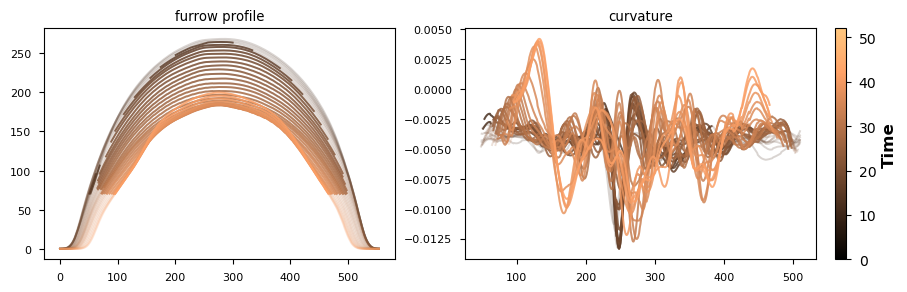

In [57]:
plt.style.use('seaborn-v0_8-paper')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 3))
sigma = 10

copper = plt.cm.copper(np.linspace(0.2, 0.8, heights.shape[0]-t0))

k2s = [] 

# Plot furrow and perpendicular profiles
for t in range(t0+1, heights.shape[0]):
    h = heights[t, :, :]
    h_smooth = gaussian_filter(h, sigma=sigma)

    k1, k2 = compute_principle_curvatures(h_smooth, h_cutoff=70, cur_cutoff=-1)
    cur = k1[y_para, x_para] 
    m = (cur > 0)
    cur2 = k2[y_para, x_para]

    ax1.plot(y_para, h_smooth[y_para, x_para], color=copper[t-t0], alpha=0.2)
    ax1.plot(y_para[m], h_smooth[y_para, x_para][m], color=copper[t-t0], alpha=0.8)
    ax2.plot(y_para, cur2, color=copper[t-t0], alpha=0.2)
    ax2.plot(y_para[m], cur2[m], color=copper[t-t0], alpha=0.8)

    k2s.append(cur2)

# Enhanced colorbar
sm = plt.cm.ScalarMappable(cmap=plt.cm.copper, norm=plt.Normalize(0, heights.shape[0]))
cbar = fig.colorbar(sm, ax=[ax1, ax2], label='Time', pad=0.02)
cbar.ax.tick_params(labelsize=10)
cbar.set_label('Time', fontsize=12, fontweight='bold')

ax1.set_title('furrow profile')
ax2.set_title('curvature')
plt.show()


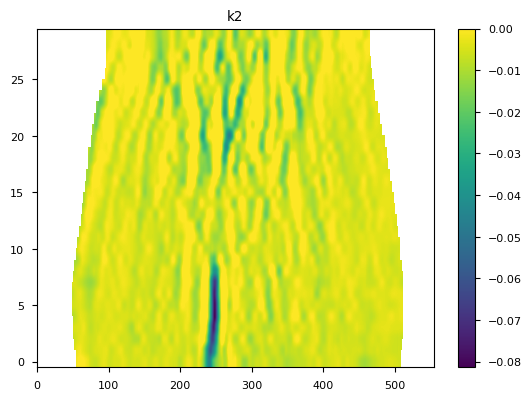

In [56]:
plt.imshow(k2s, aspect='auto', vmax=0, origin='lower')
plt.colorbar() 
plt.title('k2')
plt.show() 